In [ ]:
# This script produces streamlines from PIV analysis data



import numpy as np
import scipy.io
import matplotlib.pyplot as plt
from matplotlib.image import imread
from pathlib import Path

def load_mat_file(filepath):
    data = scipy.io.loadmat(filepath)
    return data


def main(path, im, start_timestep, feat, num_steps_to_average=5):
    mat_filepath = path
    print(f"Loading data from: {mat_filepath}")

    data = load_mat_file(mat_filepath)
    if 'U2' in data and 'V2' in data:
        U = data['U2']
        V = data['V2']
    elif 'U' in data and 'V' in data:
        U = data['U']
        V = data['V']
    else:
        print("Error: Could not find velocity fields ('U', 'V' or 'U2', 'V2') in .mat file.")
        return


    print(f"Calculating mean velocity from timestep {start_timestep} to {start_timestep + num_steps_to_average - 1}")


    if start_timestep >= U.shape[1]:
        print(f"Error: Start timestep {start_timestep} is out of bounds (max: {U.shape[1]-1})")
        return


    U_accum = np.zeros_like(U[0, start_timestep], dtype=float)
    V_accum = np.zeros_like(V[0, start_timestep], dtype=float)
    valid_step_count = 0


    for t in range(start_timestep, start_timestep + num_steps_to_average):
        if t < U.shape[1]:
            U_accum += U[0, t]
            V_accum += V[0, t]
            valid_step_count += 1
        else:
            print(f"Warning: Timestep {t} is out of bounds, skipping.")
            break

    if valid_step_count == 0:
        print("Error: No valid timesteps found in the specified range.")
        return


    U_mean = U_accum / valid_step_count
    V_mean = V_accum / valid_step_count
    print(f"Averaged over {valid_step_count} timesteps.")


    numRows, numCols = U_mean.shape
    print(f"Grid dimensions: Rows={numRows}, Cols={numCols}")
    X, Y = np.meshgrid(np.arange(numCols), np.arange(numRows))

    display_width_inches = 4
    aspect_ratio = numRows / numCols
    display_height_inches = display_width_inches * aspect_ratio



    fig, ax = plt.subplots(1, 1, figsize=(display_width_inches, display_height_inches))
    fig.subplots_adjust(left=0, right=1, top=1, bottom=0)


    image = im
    if image:
        try:
            img = imread(image)
            ax.imshow(img, extent=[0, numCols, 0, numRows], alpha=0.8, origin='lower')
        except FileNotFoundError:
            print(f"Warning: Background image not found at {image}")


    startx = np.linspace(0, numCols - 1, 20)
    starty = np.linspace(0, numRows - 1, 20)
    start_points_meshgrid = np.array(np.meshgrid(startx, starty))
    start_points = start_points_meshgrid.T.reshape(-1, 2)


    try:
        strm = ax.streamplot(X, Y, U_mean, V_mean, start_points=start_points, density=2.5, linewidth=0.8, color='blue',
                             integration_direction = 'both')
    except ValueError as e:
        print(f"Error during streamplot: {e}")
        plt.close(fig)
        return


    ax.set_xlim(0, numCols)
    ax.set_ylim(0, numRows)
    ax.set_aspect('auto')
    ax.invert_yaxis()
    ax.axis('off')

 
    p = Path(path)
    plot_save_name_parts = f"{p.parent.name}/{p.stem}"
    save_dir = Path("/uio/hume/student-u17/rafalbz/Documents/master/final/results/streamlines_mean/")

    save_filename = f"{plot_save_name_parts}_streamline_mean_{start_timestep}-{start_timestep+valid_step_count-1}.png"
    full_save_path = save_dir / save_filename
    full_save_path.parent.mkdir(parents=True, exist_ok=True)

    save_dpi = numCols / display_width_inches


    fig.savefig(full_save_path, dpi=400, pad_inches=0)
    print(f"Figure saved as: {full_save_path} with dimensions {numCols}x{numRows}")


    plt.show()


    plt.close(fig)


Loading data from: /uio/hume/student-u17/rafalbz/Documents/master/final/source/28.03/canyon_1f/PIV_run3.mat
Calculating mean velocity from timestep 41 to 45
Averaged over 5 timesteps.
Grid dimensions: Rows=55, Cols=55
Figure saved as: /uio/hume/student-u17/rafalbz/Documents/master/final/results/streamlines_mean/canyon_1f/PIV_run3_streamline_mean_41-45.png with dimensions 55x55


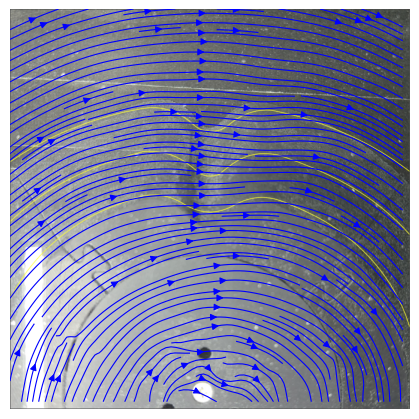

Loading data from: /uio/hume/student-u17/rafalbz/Documents/master/final/source/28.03/canyon_1f/PIV_run3.mat
Calculating mean velocity from timestep 42 to 46
Averaged over 5 timesteps.
Grid dimensions: Rows=55, Cols=55
Figure saved as: /uio/hume/student-u17/rafalbz/Documents/master/final/results/streamlines_mean/canyon_1f/PIV_run3_streamline_mean_42-46.png with dimensions 55x55


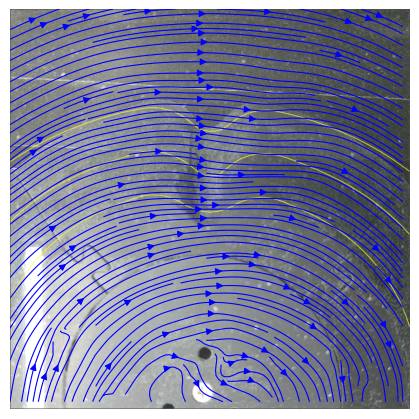

Loading data from: /uio/hume/student-u17/rafalbz/Documents/master/final/source/28.03/canyon_1f/PIV_run3.mat
Calculating mean velocity from timestep 71 to 75
Averaged over 5 timesteps.
Grid dimensions: Rows=55, Cols=55
Figure saved as: /uio/hume/student-u17/rafalbz/Documents/master/final/results/streamlines_mean/canyon_1f/PIV_run3_streamline_mean_71-75.png with dimensions 55x55


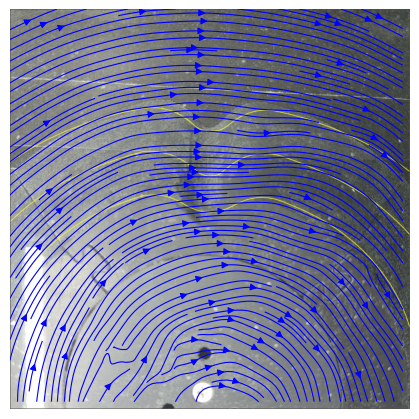

Loading data from: /uio/hume/student-u17/rafalbz/Documents/master/final/source/28.03/canyon_1f/PIV_run3.mat
Calculating mean velocity from timestep 131 to 135
Averaged over 5 timesteps.
Grid dimensions: Rows=55, Cols=55
Figure saved as: /uio/hume/student-u17/rafalbz/Documents/master/final/results/streamlines_mean/canyon_1f/PIV_run3_streamline_mean_131-135.png with dimensions 55x55


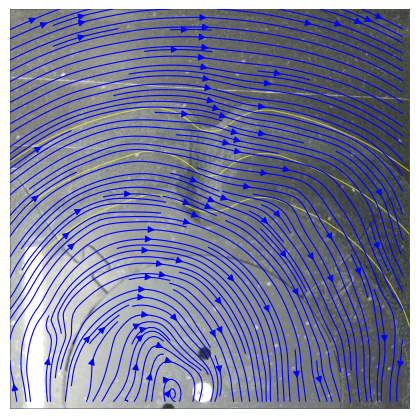

Loading data from: /uio/hume/student-u17/rafalbz/Documents/master/final/source/28.03/canyon_1f/PIV_run3.mat
Calculating mean velocity from timestep 204 to 208
Averaged over 5 timesteps.
Grid dimensions: Rows=55, Cols=55
Figure saved as: /uio/hume/student-u17/rafalbz/Documents/master/final/results/streamlines_mean/canyon_1f/PIV_run3_streamline_mean_204-208.png with dimensions 55x55


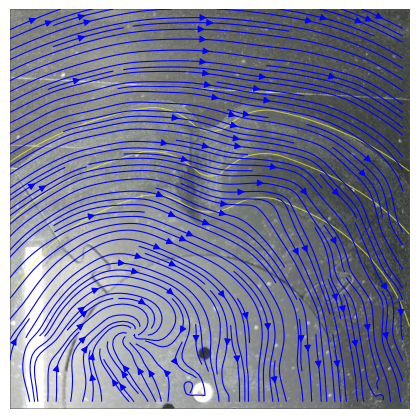

Loading data from: /uio/hume/student-u17/rafalbz/Documents/master/final/source/28.03/canyon_1f/PIV_run6.mat
Calculating mean velocity from timestep 27 to 31
Averaged over 5 timesteps.
Grid dimensions: Rows=55, Cols=55
Figure saved as: /uio/hume/student-u17/rafalbz/Documents/master/final/results/streamlines_mean/canyon_1f/PIV_run6_streamline_mean_27-31.png with dimensions 55x55


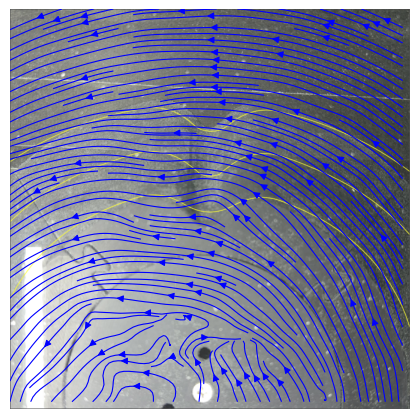

Loading data from: /uio/hume/student-u17/rafalbz/Documents/master/final/source/28.03/canyon_1f/PIV_run6.mat
Calculating mean velocity from timestep 28 to 32
Averaged over 5 timesteps.
Grid dimensions: Rows=55, Cols=55
Figure saved as: /uio/hume/student-u17/rafalbz/Documents/master/final/results/streamlines_mean/canyon_1f/PIV_run6_streamline_mean_28-32.png with dimensions 55x55


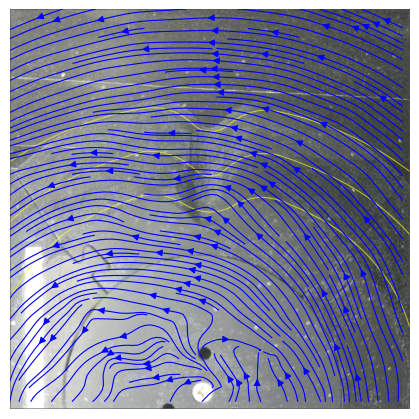

Loading data from: /uio/hume/student-u17/rafalbz/Documents/master/final/source/28.03/canyon_1f/PIV_run6.mat
Calculating mean velocity from timestep 57 to 61
Averaged over 5 timesteps.
Grid dimensions: Rows=55, Cols=55
Figure saved as: /uio/hume/student-u17/rafalbz/Documents/master/final/results/streamlines_mean/canyon_1f/PIV_run6_streamline_mean_57-61.png with dimensions 55x55


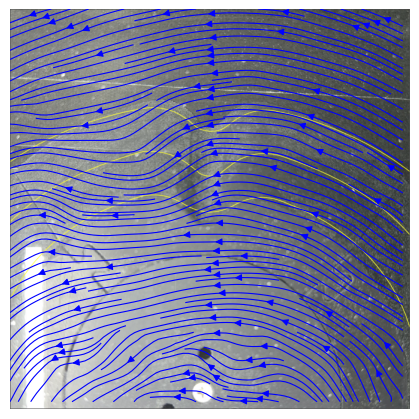

Loading data from: /uio/hume/student-u17/rafalbz/Documents/master/final/source/28.03/canyon_1f/PIV_run6.mat
Calculating mean velocity from timestep 117 to 121
Averaged over 5 timesteps.
Grid dimensions: Rows=55, Cols=55
Figure saved as: /uio/hume/student-u17/rafalbz/Documents/master/final/results/streamlines_mean/canyon_1f/PIV_run6_streamline_mean_117-121.png with dimensions 55x55


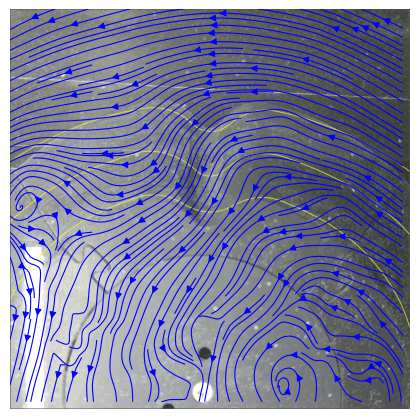

Loading data from: /uio/hume/student-u17/rafalbz/Documents/master/final/source/28.03/canyon_1f/PIV_run6.mat
Calculating mean velocity from timestep 190 to 194
Averaged over 5 timesteps.
Grid dimensions: Rows=55, Cols=55
Figure saved as: /uio/hume/student-u17/rafalbz/Documents/master/final/results/streamlines_mean/canyon_1f/PIV_run6_streamline_mean_190-194.png with dimensions 55x55


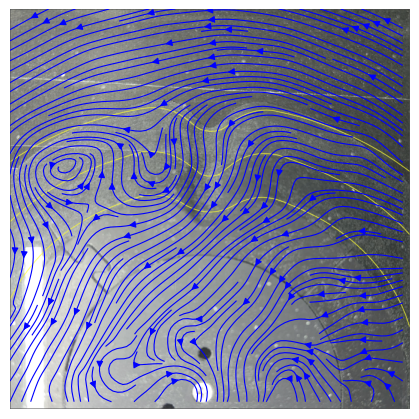

Loading data from: /uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_1f/PIV_run1.mat
Calculating mean velocity from timestep 20 to 24
Averaged over 5 timesteps.
Grid dimensions: Rows=55, Cols=55
Figure saved as: /uio/hume/student-u17/rafalbz/Documents/master/final/results/streamlines_mean/smooth_1f/PIV_run1_streamline_mean_20-24.png with dimensions 55x55


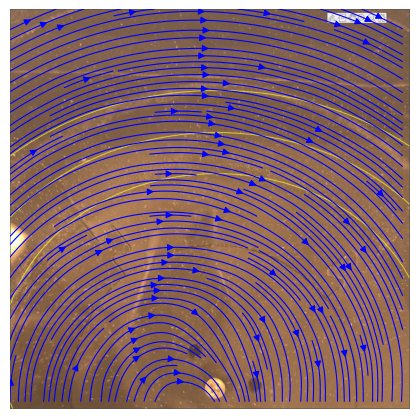

Loading data from: /uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_1f/PIV_run1.mat
Calculating mean velocity from timestep 21 to 25
Averaged over 5 timesteps.
Grid dimensions: Rows=55, Cols=55
Figure saved as: /uio/hume/student-u17/rafalbz/Documents/master/final/results/streamlines_mean/smooth_1f/PIV_run1_streamline_mean_21-25.png with dimensions 55x55


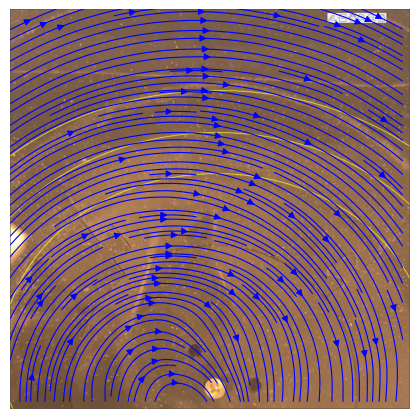

Loading data from: /uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_1f/PIV_run1.mat
Calculating mean velocity from timestep 50 to 54
Averaged over 5 timesteps.
Grid dimensions: Rows=55, Cols=55
Figure saved as: /uio/hume/student-u17/rafalbz/Documents/master/final/results/streamlines_mean/smooth_1f/PIV_run1_streamline_mean_50-54.png with dimensions 55x55


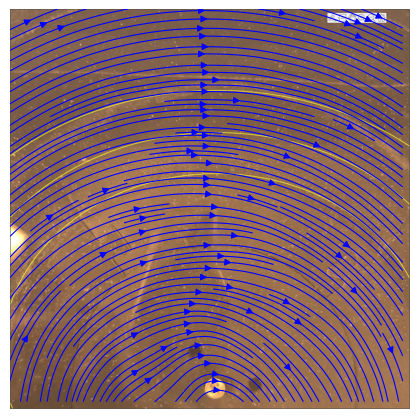

Loading data from: /uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_1f/PIV_run1.mat
Calculating mean velocity from timestep 110 to 114
Averaged over 5 timesteps.
Grid dimensions: Rows=55, Cols=55
Figure saved as: /uio/hume/student-u17/rafalbz/Documents/master/final/results/streamlines_mean/smooth_1f/PIV_run1_streamline_mean_110-114.png with dimensions 55x55


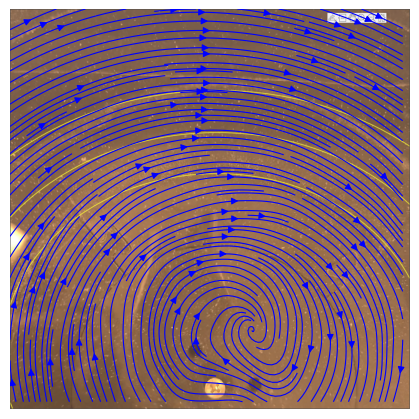

Loading data from: /uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_1f/PIV_run1.mat
Calculating mean velocity from timestep 183 to 187
Averaged over 5 timesteps.
Grid dimensions: Rows=55, Cols=55
Figure saved as: /uio/hume/student-u17/rafalbz/Documents/master/final/results/streamlines_mean/smooth_1f/PIV_run1_streamline_mean_183-187.png with dimensions 55x55


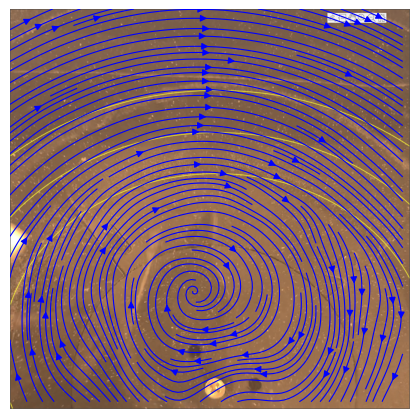

In [43]:

main('/uio/hume/student-u17/rafalbz/Documents/master/final/source/28.03/canyon_1f/PIV_run3.mat',
      '/uio/hume/student-u17/rafalbz/Documents/master/final/source/28.03/canyon_contour.png', 41,'Canyon')
main('/uio/hume/student-u17/rafalbz/Documents/master/final/source/28.03/canyon_1f/PIV_run3.mat',
      '/uio/hume/student-u17/rafalbz/Documents/master/final/source/28.03/canyon_contour.png', 41+3-2,'Canyon')
main('/uio/hume/student-u17/rafalbz/Documents/master/final/source/28.03/canyon_1f/PIV_run3.mat',
      '/uio/hume/student-u17/rafalbz/Documents/master/final/source/28.03/canyon_contour.png', 41+32-2,'Canyon')
main('/uio/hume/student-u17/rafalbz/Documents/master/final/source/28.03/canyon_1f/PIV_run3.mat',
      '/uio/hume/student-u17/rafalbz/Documents/master/final/source/28.03/canyon_contour.png', 41+92-2,'Canyon')
main('/uio/hume/student-u17/rafalbz/Documents/master/final/source/28.03/canyon_1f/PIV_run3.mat',
      '/uio/hume/student-u17/rafalbz/Documents/master/final/source/28.03/canyon_contour.png', 41+165-2,'Canyon')



main('/uio/hume/student-u17/rafalbz/Documents/master/final/source/28.03/canyon_1f/PIV_run6.mat',
      '/uio/hume/student-u17/rafalbz/Documents/master/final/source/28.03/canyon_contour.png', 27,'Canyon')
main('/uio/hume/student-u17/rafalbz/Documents/master/final/source/28.03/canyon_1f/PIV_run6.mat',
      '/uio/hume/student-u17/rafalbz/Documents/master/final/source/28.03/canyon_contour.png', 27+3-2,'Canyon')
main('/uio/hume/student-u17/rafalbz/Documents/master/final/source/28.03/canyon_1f/PIV_run6.mat',
      '/uio/hume/student-u17/rafalbz/Documents/master/final/source/28.03/canyon_contour.png', 27+32-2,'Canyon')
main('/uio/hume/student-u17/rafalbz/Documents/master/final/source/28.03/canyon_1f/PIV_run6.mat',
      '/uio/hume/student-u17/rafalbz/Documents/master/final/source/28.03/canyon_contour.png', 27+92-2,'Canyon')
main('/uio/hume/student-u17/rafalbz/Documents/master/final/source/28.03/canyon_1f/PIV_run6.mat',
      '/uio/hume/student-u17/rafalbz/Documents/master/final/source/28.03/canyon_contour.png', 27+165-2,'Canyon')

main('/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_1f/PIV_run1.mat',
      '/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_contour.png', 20, 'Smooth')
main('/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_1f/PIV_run1.mat',
      '/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_contour.png', 20+3-2,'Smooth')
main('/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_1f/PIV_run1.mat',
      '/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_contour.png', 20+32-2,'Smooth')
main('/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_1f/PIV_run1.mat',
      '/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_contour.png', 20+92-2,'Smooth')
main('/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_1f/PIV_run1.mat',
      '/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_contour.png', 20+165-2,'Smooth')


Loading data from: /uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_1f/PIV_run2.mat
Calculating mean velocity from timestep 23 to 27
Averaged over 5 timesteps.
Grid dimensions: Rows=55, Cols=55
Figure saved as: /uio/hume/student-u17/rafalbz/Documents/master/final/results/streamlines_mean/smooth_1f/PIV_run2_streamline_mean_23-27.png with dimensions 55x55


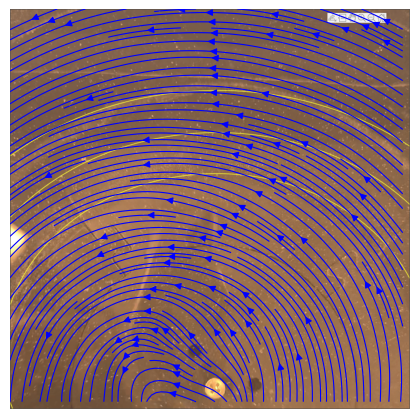

Loading data from: /uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_1f/PIV_run2.mat
Calculating mean velocity from timestep 24 to 28
Averaged over 5 timesteps.
Grid dimensions: Rows=55, Cols=55
Figure saved as: /uio/hume/student-u17/rafalbz/Documents/master/final/results/streamlines_mean/smooth_1f/PIV_run2_streamline_mean_24-28.png with dimensions 55x55


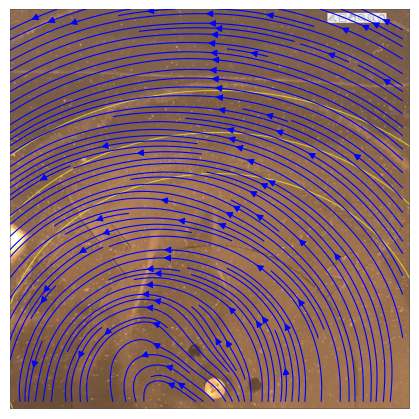

Loading data from: /uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_1f/PIV_run2.mat
Calculating mean velocity from timestep 53 to 57
Averaged over 5 timesteps.
Grid dimensions: Rows=55, Cols=55
Figure saved as: /uio/hume/student-u17/rafalbz/Documents/master/final/results/streamlines_mean/smooth_1f/PIV_run2_streamline_mean_53-57.png with dimensions 55x55


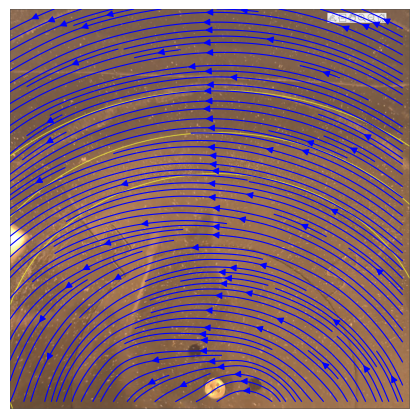

Loading data from: /uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_1f/PIV_run2.mat
Calculating mean velocity from timestep 113 to 117
Averaged over 5 timesteps.
Grid dimensions: Rows=55, Cols=55
Figure saved as: /uio/hume/student-u17/rafalbz/Documents/master/final/results/streamlines_mean/smooth_1f/PIV_run2_streamline_mean_113-117.png with dimensions 55x55


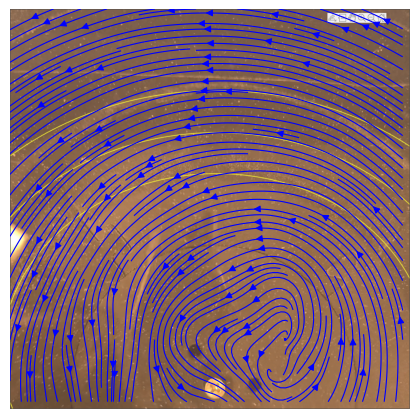

Loading data from: /uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_1f/PIV_run2.mat
Calculating mean velocity from timestep 186 to 190
Averaged over 5 timesteps.
Grid dimensions: Rows=55, Cols=55
Figure saved as: /uio/hume/student-u17/rafalbz/Documents/master/final/results/streamlines_mean/smooth_1f/PIV_run2_streamline_mean_186-190.png with dimensions 55x55


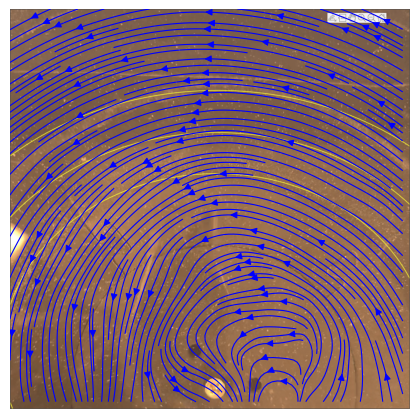

Loading data from: /uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_2f/PIV_run1.mat
Calculating mean velocity from timestep 28 to 32
Averaged over 5 timesteps.
Grid dimensions: Rows=55, Cols=55
Figure saved as: /uio/hume/student-u17/rafalbz/Documents/master/final/results/streamlines_mean/smooth_2f/PIV_run1_streamline_mean_28-32.png with dimensions 55x55


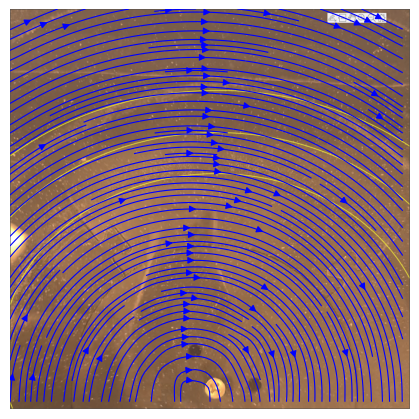

Loading data from: /uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_2f/PIV_run1.mat
Calculating mean velocity from timestep 29 to 33
Averaged over 5 timesteps.
Grid dimensions: Rows=55, Cols=55
Figure saved as: /uio/hume/student-u17/rafalbz/Documents/master/final/results/streamlines_mean/smooth_2f/PIV_run1_streamline_mean_29-33.png with dimensions 55x55


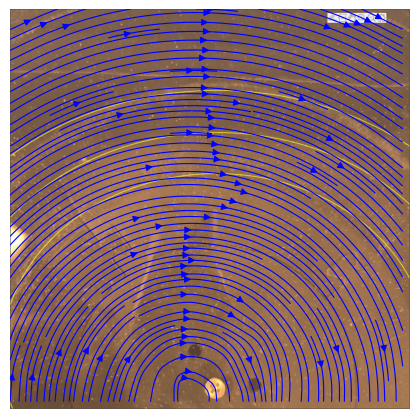

Loading data from: /uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_2f/PIV_run1.mat
Calculating mean velocity from timestep 58 to 62
Averaged over 5 timesteps.
Grid dimensions: Rows=55, Cols=55
Figure saved as: /uio/hume/student-u17/rafalbz/Documents/master/final/results/streamlines_mean/smooth_2f/PIV_run1_streamline_mean_58-62.png with dimensions 55x55


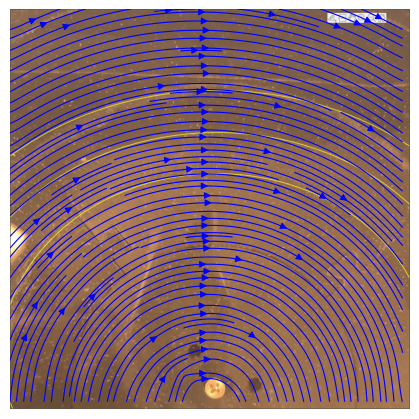

Loading data from: /uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_2f/PIV_run1.mat
Calculating mean velocity from timestep 118 to 122
Averaged over 5 timesteps.
Grid dimensions: Rows=55, Cols=55
Figure saved as: /uio/hume/student-u17/rafalbz/Documents/master/final/results/streamlines_mean/smooth_2f/PIV_run1_streamline_mean_118-122.png with dimensions 55x55


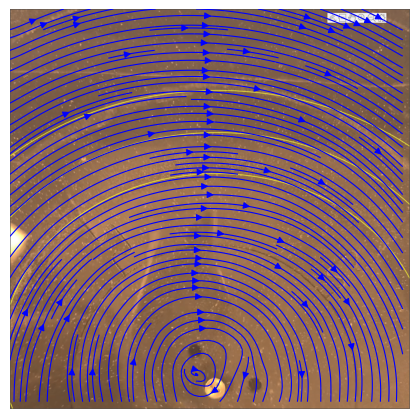

Loading data from: /uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_2f/PIV_run1.mat
Calculating mean velocity from timestep 191 to 195
Averaged over 5 timesteps.
Grid dimensions: Rows=55, Cols=55
Figure saved as: /uio/hume/student-u17/rafalbz/Documents/master/final/results/streamlines_mean/smooth_2f/PIV_run1_streamline_mean_191-195.png with dimensions 55x55


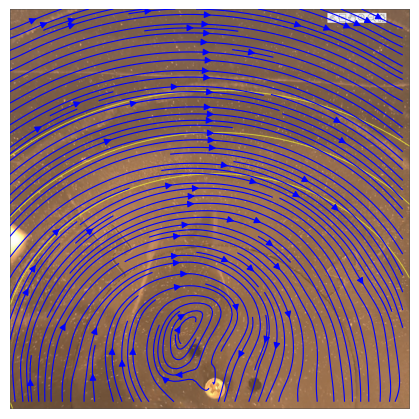

Loading data from: /uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_2f/PIV_run2.mat
Calculating mean velocity from timestep 28 to 32
Averaged over 5 timesteps.
Grid dimensions: Rows=55, Cols=55
Figure saved as: /uio/hume/student-u17/rafalbz/Documents/master/final/results/streamlines_mean/smooth_2f/PIV_run2_streamline_mean_28-32.png with dimensions 55x55


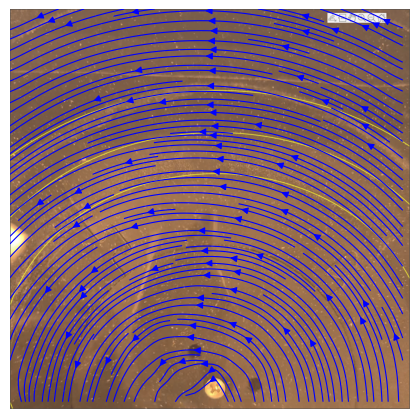

Loading data from: /uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_2f/PIV_run2.mat
Calculating mean velocity from timestep 29 to 33
Averaged over 5 timesteps.
Grid dimensions: Rows=55, Cols=55
Figure saved as: /uio/hume/student-u17/rafalbz/Documents/master/final/results/streamlines_mean/smooth_2f/PIV_run2_streamline_mean_29-33.png with dimensions 55x55


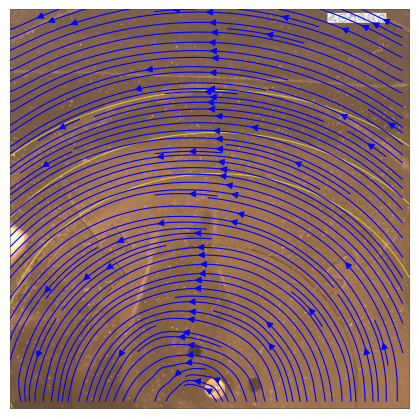

Loading data from: /uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_2f/PIV_run2.mat
Calculating mean velocity from timestep 58 to 62
Averaged over 5 timesteps.
Grid dimensions: Rows=55, Cols=55
Figure saved as: /uio/hume/student-u17/rafalbz/Documents/master/final/results/streamlines_mean/smooth_2f/PIV_run2_streamline_mean_58-62.png with dimensions 55x55


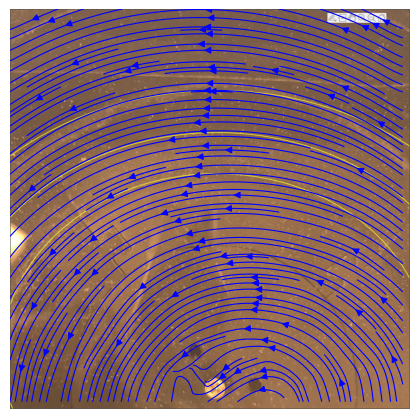

Loading data from: /uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_2f/PIV_run2.mat
Calculating mean velocity from timestep 118 to 122
Averaged over 5 timesteps.
Grid dimensions: Rows=55, Cols=55
Figure saved as: /uio/hume/student-u17/rafalbz/Documents/master/final/results/streamlines_mean/smooth_2f/PIV_run2_streamline_mean_118-122.png with dimensions 55x55


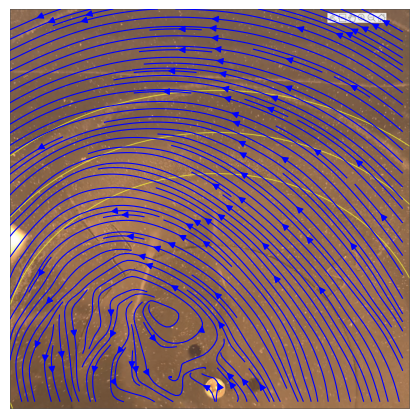

Loading data from: /uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_2f/PIV_run2.mat
Calculating mean velocity from timestep 191 to 195
Averaged over 5 timesteps.
Grid dimensions: Rows=55, Cols=55
Figure saved as: /uio/hume/student-u17/rafalbz/Documents/master/final/results/streamlines_mean/smooth_2f/PIV_run2_streamline_mean_191-195.png with dimensions 55x55


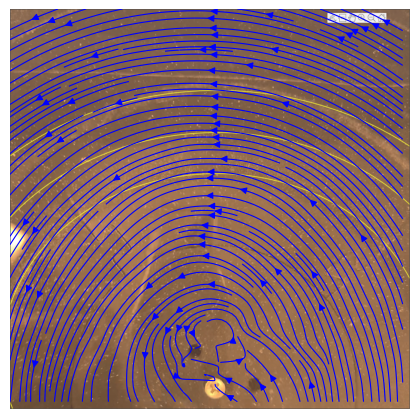

In [44]:

main('/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_1f/PIV_run2.mat',
      '/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_contour.png', 23,'Smooth')
main('/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_1f/PIV_run2.mat',
      '/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_contour.png', 23+3-2,'Smooth')
main('/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_1f/PIV_run2.mat',
      '/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_contour.png', 23+32-2,'Smooth')
main('/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_1f/PIV_run2.mat',
      '/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_contour.png', 23+92-2,'Smooth')
main('/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_1f/PIV_run2.mat',
      '/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_contour.png', 23+165-2,'Smooth')

main('/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_2f/PIV_run1.mat',
      '/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_contour.png', 28,'Smooth')
main('/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_2f/PIV_run1.mat',
      '/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_contour.png', 28+3-2,'Smooth')
main('/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_2f/PIV_run1.mat',
      '/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_contour.png', 28+32-2,'Smooth')
main('/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_2f/PIV_run1.mat',
      '/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_contour.png', 28+92-2,'Smooth')
main('/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_2f/PIV_run1.mat',
      '/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_contour.png', 28+165-2,'Smooth')

main('/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_2f/PIV_run2.mat',
      '/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_contour.png', 28,'Smooth')
main('/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_2f/PIV_run2.mat',
      '/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_contour.png', 28+3-2,'Smooth')
main('/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_2f/PIV_run2.mat',
      '/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_contour.png', 28+32-2,'Smooth')
main('/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_2f/PIV_run2.mat',
      '/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_contour.png', 28+92-2,'Smooth')
main('/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_2f/PIV_run2.mat',
      '/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_contour.png', 28+165-2,'Smooth')

Loading data from: /uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/canyon_2f/PIV_run4.mat
Calculating mean velocity from timestep 14 to 18
Averaged over 5 timesteps.
Grid dimensions: Rows=55, Cols=55
Figure saved as: /uio/hume/student-u17/rafalbz/Documents/master/final/results/streamlines_mean/canyon_2f/PIV_run4_streamline_mean_14-18.png with dimensions 55x55


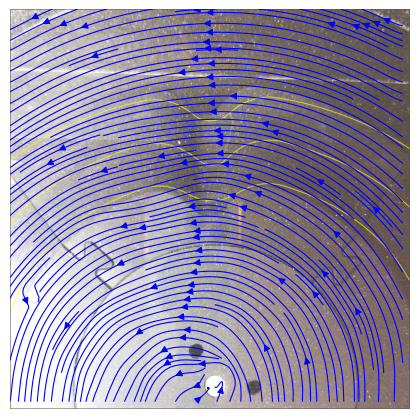

Loading data from: /uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/canyon_2f/PIV_run4.mat
Calculating mean velocity from timestep 15 to 19
Averaged over 5 timesteps.
Grid dimensions: Rows=55, Cols=55
Figure saved as: /uio/hume/student-u17/rafalbz/Documents/master/final/results/streamlines_mean/canyon_2f/PIV_run4_streamline_mean_15-19.png with dimensions 55x55


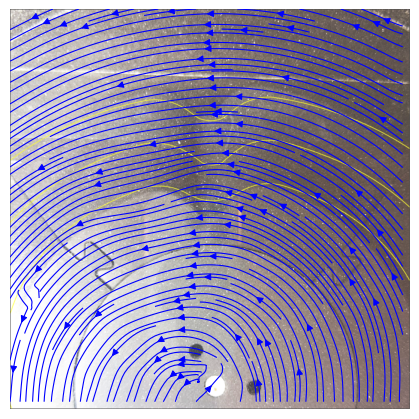

Loading data from: /uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/canyon_2f/PIV_run4.mat
Calculating mean velocity from timestep 44 to 48
Averaged over 5 timesteps.
Grid dimensions: Rows=55, Cols=55
Figure saved as: /uio/hume/student-u17/rafalbz/Documents/master/final/results/streamlines_mean/canyon_2f/PIV_run4_streamline_mean_44-48.png with dimensions 55x55


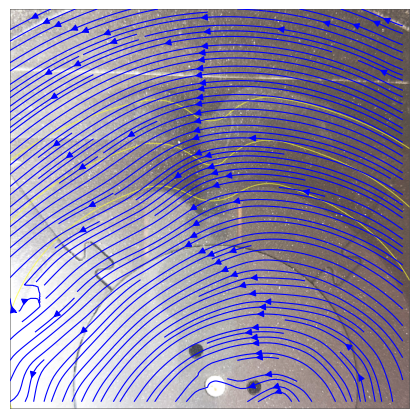

Loading data from: /uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/canyon_2f/PIV_run4.mat
Calculating mean velocity from timestep 104 to 108
Averaged over 5 timesteps.
Grid dimensions: Rows=55, Cols=55
Figure saved as: /uio/hume/student-u17/rafalbz/Documents/master/final/results/streamlines_mean/canyon_2f/PIV_run4_streamline_mean_104-108.png with dimensions 55x55


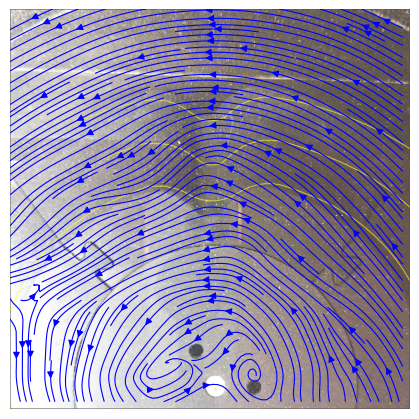

Loading data from: /uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/canyon_2f/PIV_run4.mat
Calculating mean velocity from timestep 177 to 181
Averaged over 5 timesteps.
Grid dimensions: Rows=55, Cols=55
Figure saved as: /uio/hume/student-u17/rafalbz/Documents/master/final/results/streamlines_mean/canyon_2f/PIV_run4_streamline_mean_177-181.png with dimensions 55x55


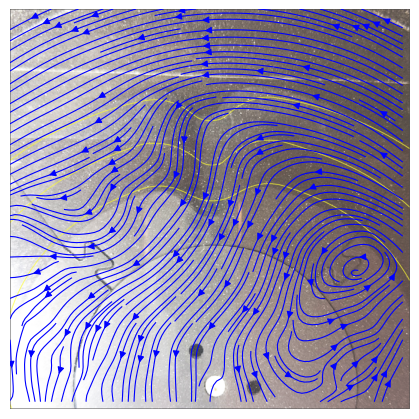

Loading data from: /uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/canyon_2f/PIV_run3.mat
Calculating mean velocity from timestep 32 to 36
Averaged over 5 timesteps.
Grid dimensions: Rows=55, Cols=55
Figure saved as: /uio/hume/student-u17/rafalbz/Documents/master/final/results/streamlines_mean/canyon_2f/PIV_run3_streamline_mean_32-36.png with dimensions 55x55


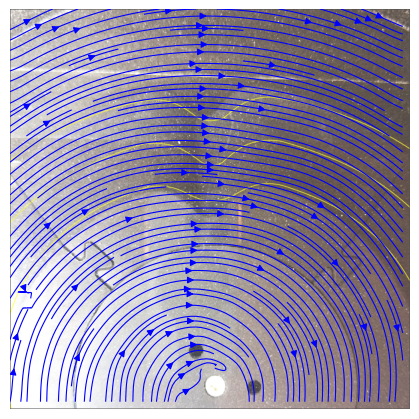

Loading data from: /uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/canyon_2f/PIV_run3.mat
Calculating mean velocity from timestep 33 to 37
Averaged over 5 timesteps.
Grid dimensions: Rows=55, Cols=55
Figure saved as: /uio/hume/student-u17/rafalbz/Documents/master/final/results/streamlines_mean/canyon_2f/PIV_run3_streamline_mean_33-37.png with dimensions 55x55


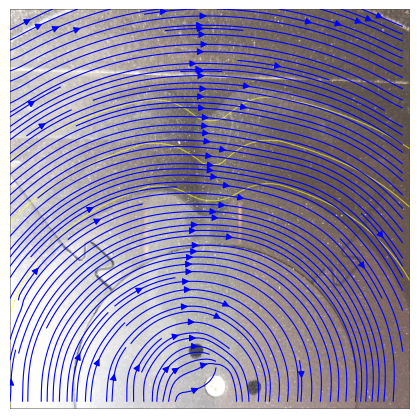

Loading data from: /uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/canyon_2f/PIV_run3.mat
Calculating mean velocity from timestep 62 to 66
Averaged over 5 timesteps.
Grid dimensions: Rows=55, Cols=55
Figure saved as: /uio/hume/student-u17/rafalbz/Documents/master/final/results/streamlines_mean/canyon_2f/PIV_run3_streamline_mean_62-66.png with dimensions 55x55


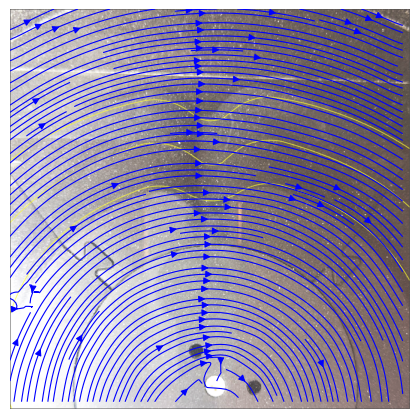

Loading data from: /uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/canyon_2f/PIV_run3.mat
Calculating mean velocity from timestep 122 to 126
Averaged over 5 timesteps.
Grid dimensions: Rows=55, Cols=55
Figure saved as: /uio/hume/student-u17/rafalbz/Documents/master/final/results/streamlines_mean/canyon_2f/PIV_run3_streamline_mean_122-126.png with dimensions 55x55


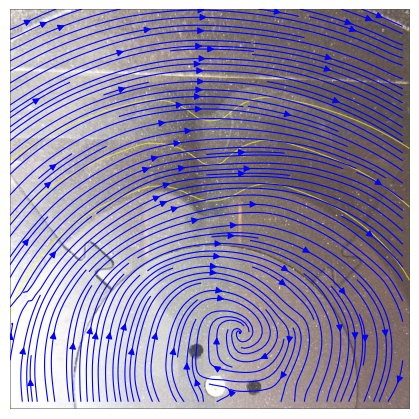

Loading data from: /uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/canyon_2f/PIV_run3.mat
Calculating mean velocity from timestep 195 to 199
Averaged over 5 timesteps.
Grid dimensions: Rows=55, Cols=55
Figure saved as: /uio/hume/student-u17/rafalbz/Documents/master/final/results/streamlines_mean/canyon_2f/PIV_run3_streamline_mean_195-199.png with dimensions 55x55


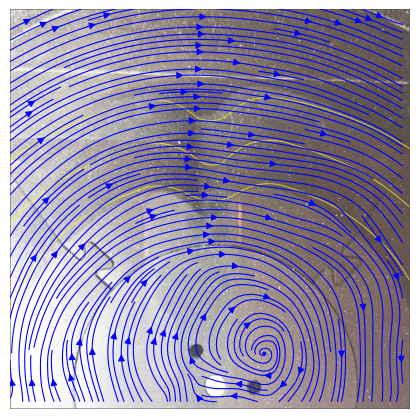

Loading data from: /uio/hume/student-u17/rafalbz/Documents/master/final/source/28.03/canyon_1f/PIV_run3.mat
Calculating mean velocity from timestep 41 to 45
Averaged over 5 timesteps.
Grid dimensions: Rows=55, Cols=55
Figure saved as: /uio/hume/student-u17/rafalbz/Documents/master/final/results/streamlines_mean/canyon_1f/PIV_run3_streamline_mean_41-45.png with dimensions 55x55


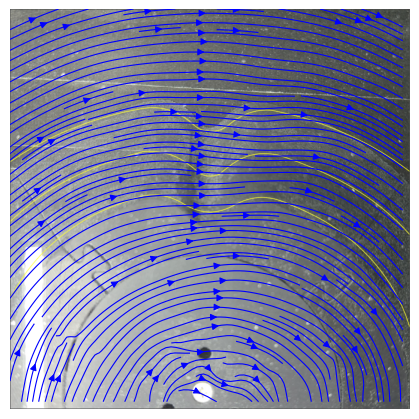

Loading data from: /uio/hume/student-u17/rafalbz/Documents/master/final/source/28.03/canyon_1f/PIV_run3.mat
Calculating mean velocity from timestep 42 to 46
Averaged over 5 timesteps.
Grid dimensions: Rows=55, Cols=55
Figure saved as: /uio/hume/student-u17/rafalbz/Documents/master/final/results/streamlines_mean/canyon_1f/PIV_run3_streamline_mean_42-46.png with dimensions 55x55


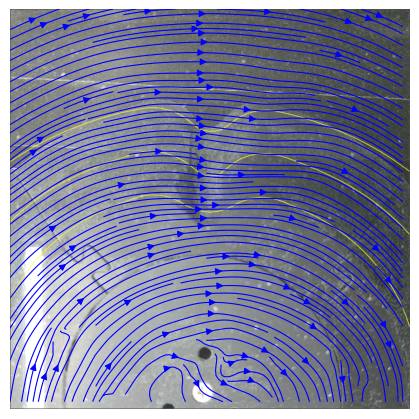

Loading data from: /uio/hume/student-u17/rafalbz/Documents/master/final/source/28.03/canyon_1f/PIV_run3.mat
Calculating mean velocity from timestep 71 to 75
Averaged over 5 timesteps.
Grid dimensions: Rows=55, Cols=55
Figure saved as: /uio/hume/student-u17/rafalbz/Documents/master/final/results/streamlines_mean/canyon_1f/PIV_run3_streamline_mean_71-75.png with dimensions 55x55


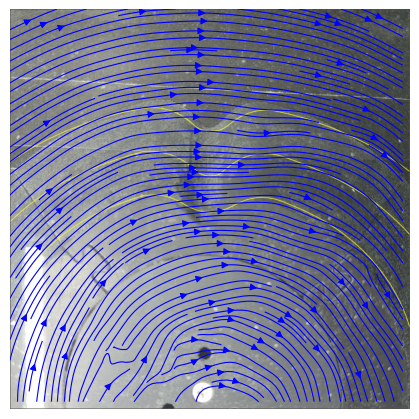

Loading data from: /uio/hume/student-u17/rafalbz/Documents/master/final/source/28.03/canyon_1f/PIV_run3.mat
Calculating mean velocity from timestep 131 to 135
Averaged over 5 timesteps.
Grid dimensions: Rows=55, Cols=55
Figure saved as: /uio/hume/student-u17/rafalbz/Documents/master/final/results/streamlines_mean/canyon_1f/PIV_run3_streamline_mean_131-135.png with dimensions 55x55


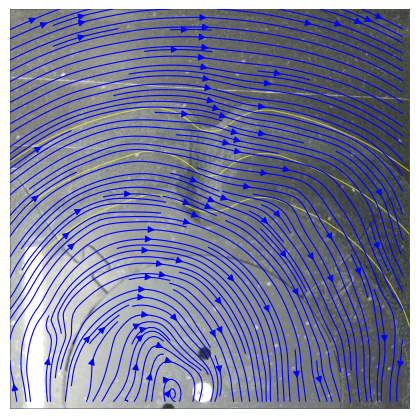

Loading data from: /uio/hume/student-u17/rafalbz/Documents/master/final/source/28.03/canyon_1f/PIV_run3.mat
Calculating mean velocity from timestep 204 to 208
Averaged over 5 timesteps.
Grid dimensions: Rows=55, Cols=55
Figure saved as: /uio/hume/student-u17/rafalbz/Documents/master/final/results/streamlines_mean/canyon_1f/PIV_run3_streamline_mean_204-208.png with dimensions 55x55


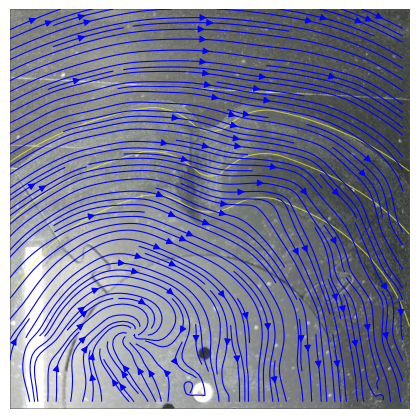

Loading data from: /uio/hume/student-u17/rafalbz/Documents/master/final/source/28.03/canyon_1f/PIV_run6.mat
Calculating mean velocity from timestep 27 to 31
Averaged over 5 timesteps.
Grid dimensions: Rows=55, Cols=55
Figure saved as: /uio/hume/student-u17/rafalbz/Documents/master/final/results/streamlines_mean/canyon_1f/PIV_run6_streamline_mean_27-31.png with dimensions 55x55


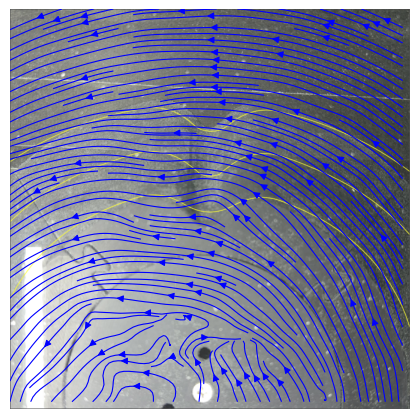

Loading data from: /uio/hume/student-u17/rafalbz/Documents/master/final/source/28.03/canyon_1f/PIV_run6.mat
Calculating mean velocity from timestep 28 to 32
Averaged over 5 timesteps.
Grid dimensions: Rows=55, Cols=55
Figure saved as: /uio/hume/student-u17/rafalbz/Documents/master/final/results/streamlines_mean/canyon_1f/PIV_run6_streamline_mean_28-32.png with dimensions 55x55


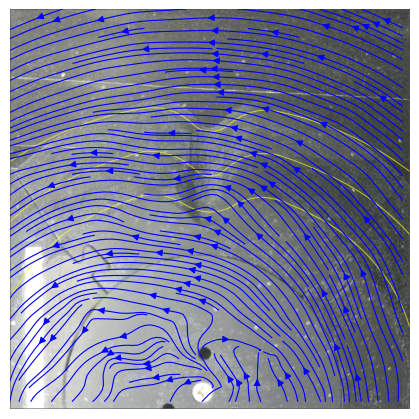

Loading data from: /uio/hume/student-u17/rafalbz/Documents/master/final/source/28.03/canyon_1f/PIV_run6.mat
Calculating mean velocity from timestep 57 to 61
Averaged over 5 timesteps.
Grid dimensions: Rows=55, Cols=55
Figure saved as: /uio/hume/student-u17/rafalbz/Documents/master/final/results/streamlines_mean/canyon_1f/PIV_run6_streamline_mean_57-61.png with dimensions 55x55


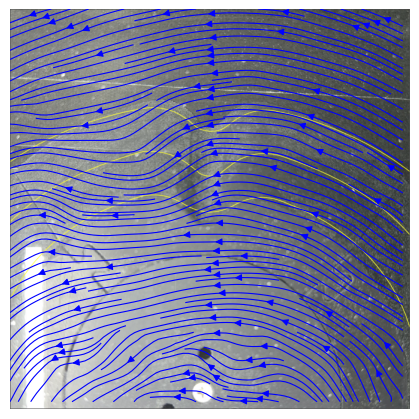

Loading data from: /uio/hume/student-u17/rafalbz/Documents/master/final/source/28.03/canyon_1f/PIV_run6.mat
Calculating mean velocity from timestep 117 to 121
Averaged over 5 timesteps.
Grid dimensions: Rows=55, Cols=55
Figure saved as: /uio/hume/student-u17/rafalbz/Documents/master/final/results/streamlines_mean/canyon_1f/PIV_run6_streamline_mean_117-121.png with dimensions 55x55


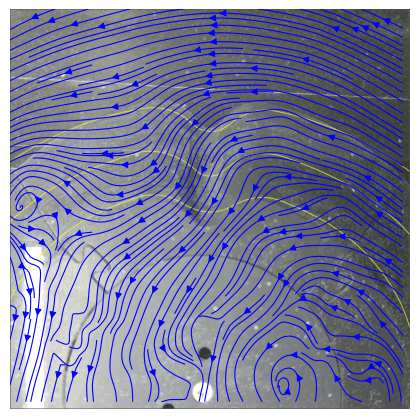

Loading data from: /uio/hume/student-u17/rafalbz/Documents/master/final/source/28.03/canyon_1f/PIV_run6.mat
Calculating mean velocity from timestep 190 to 194
Averaged over 5 timesteps.
Grid dimensions: Rows=55, Cols=55
Figure saved as: /uio/hume/student-u17/rafalbz/Documents/master/final/results/streamlines_mean/canyon_1f/PIV_run6_streamline_mean_190-194.png with dimensions 55x55


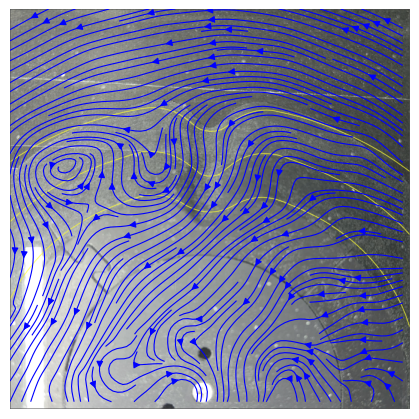

In [ ]:
main('/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/canyon_2f/PIV_run4.mat',
      '/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/canyon_contour.png', 14,'Canyon')
main('/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/canyon_2f/PIV_run4.mat',
      '/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/canyon_contour.png', 14+3-2,'Canyon')
main('/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/canyon_2f/PIV_run4.mat',
      '/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/canyon_contour.png', 14+32-2,'Canyon')
main('/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/canyon_2f/PIV_run4.mat',
      '/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/canyon_contour.png', 14+92-2,'Canyon')
main('/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/canyon_2f/PIV_run4.mat',
      '/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/canyon_contour.png', 14+165-2,'Canyon')


main('/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/canyon_2f/PIV_run3.mat',
      '/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/canyon_contour.png', 32,'Canyon')
main('/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/canyon_2f/PIV_run3.mat',
      '/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/canyon_contour.png', 32+3-2,'Canyon')
main('/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/canyon_2f/PIV_run3.mat',
      '/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/canyon_contour.png', 32+32-2,'Canyon')
main('/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/canyon_2f/PIV_run3.mat',
      '/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/canyon_contour.png', 32+92-2,'Canyon')
main('/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/canyon_2f/PIV_run3.mat',
      '/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/canyon_contour.png', 32+165-2,'Canyon')

main('/uio/hume/student-u17/rafalbz/Documents/master/final/source/28.03/canyon_1f/PIV_run3.mat',
      '/uio/hume/student-u17/rafalbz/Documents/master/final/source/28.03/canyon_contour.png', 41,'Canyon')
main('/uio/hume/student-u17/rafalbz/Documents/master/final/source/28.03/canyon_1f/PIV_run3.mat',
      '/uio/hume/student-u17/rafalbz/Documents/master/final/source/28.03/canyon_contour.png', 41+3-2,'Canyon')
main('/uio/hume/student-u17/rafalbz/Documents/master/final/source/28.03/canyon_1f/PIV_run3.mat',
      '/uio/hume/student-u17/rafalbz/Documents/master/final/source/28.03/canyon_contour.png', 41+32-2,'Canyon')
main('/uio/hume/student-u17/rafalbz/Documents/master/final/source/28.03/canyon_1f/PIV_run3.mat',
      '/uio/hume/student-u17/rafalbz/Documents/master/final/source/28.03/canyon_contour.png', 41+92-2,'Canyon')
main('/uio/hume/student-u17/rafalbz/Documents/master/final/source/28.03/canyon_1f/PIV_run3.mat',
      '/uio/hume/student-u17/rafalbz/Documents/master/final/source/28.03/canyon_contour.png', 41+165-2,'Canyon')



main('/uio/hume/student-u17/rafalbz/Documents/master/final/source/28.03/canyon_1f/PIV_run6.mat',
      '/uio/hume/student-u17/rafalbz/Documents/master/final/source/28.03/canyon_contour.png', 27,'Canyon')
main('/uio/hume/student-u17/rafalbz/Documents/master/final/source/28.03/canyon_1f/PIV_run6.mat',
      '/uio/hume/student-u17/rafalbz/Documents/master/final/source/28.03/canyon_contour.png', 27+3-2,'Canyon')
main('/uio/hume/student-u17/rafalbz/Documents/master/final/source/28.03/canyon_1f/PIV_run6.mat',
      '/uio/hume/student-u17/rafalbz/Documents/master/final/source/28.03/canyon_contour.png', 27+32-2,'Canyon')
main('/uio/hume/student-u17/rafalbz/Documents/master/final/source/28.03/canyon_1f/PIV_run6.mat',
      '/uio/hume/student-u17/rafalbz/Documents/master/final/source/28.03/canyon_contour.png', 27+92-2,'Canyon')
main('/uio/hume/student-u17/rafalbz/Documents/master/final/source/28.03/canyon_1f/PIV_run6.mat',
      '/uio/hume/student-u17/rafalbz/Documents/master/final/source/28.03/canyon_contour.png', 27+165-2,'Canyon')


Loading data from: /uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_1f/PIV_run1.mat
Calculating mean velocity from timestep 20 to 24
Averaged over 5 timesteps.
Grid dimensions: Rows=55, Cols=55
Figure saved as: /uio/hume/student-u17/rafalbz/Documents/master/final/results/streamlines_mean/smooth_1f/PIV_run1_streamline_mean_20-24.png with dimensions 55x55


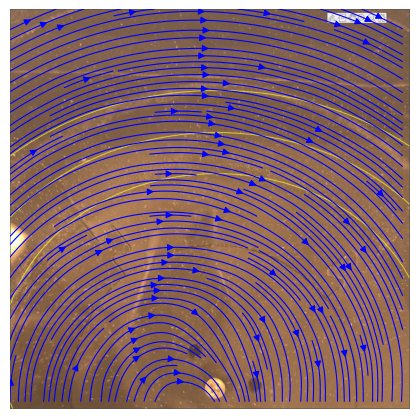

Loading data from: /uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_1f/PIV_run1.mat
Calculating mean velocity from timestep 23 to 27
Averaged over 5 timesteps.
Grid dimensions: Rows=55, Cols=55
Figure saved as: /uio/hume/student-u17/rafalbz/Documents/master/final/results/streamlines_mean/smooth_1f/PIV_run1_streamline_mean_23-27.png with dimensions 55x55


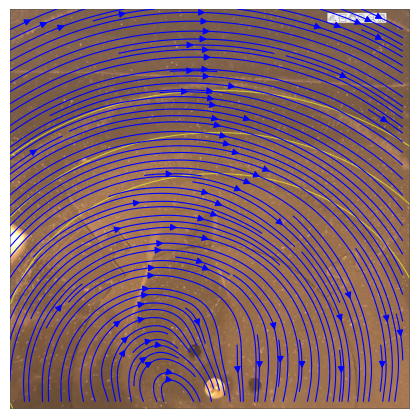

Loading data from: /uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_1f/PIV_run1.mat
Calculating mean velocity from timestep 52 to 56
Averaged over 5 timesteps.
Grid dimensions: Rows=55, Cols=55
Figure saved as: /uio/hume/student-u17/rafalbz/Documents/master/final/results/streamlines_mean/smooth_1f/PIV_run1_streamline_mean_52-56.png with dimensions 55x55


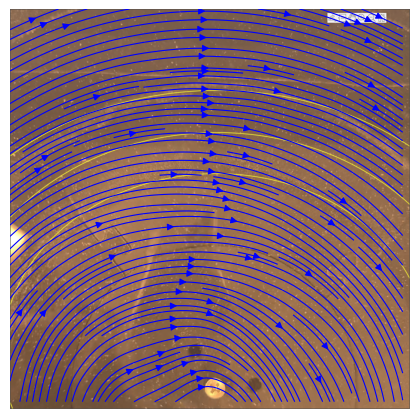

Loading data from: /uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_1f/PIV_run1.mat
Calculating mean velocity from timestep 112 to 116
Averaged over 5 timesteps.
Grid dimensions: Rows=55, Cols=55
Figure saved as: /uio/hume/student-u17/rafalbz/Documents/master/final/results/streamlines_mean/smooth_1f/PIV_run1_streamline_mean_112-116.png with dimensions 55x55


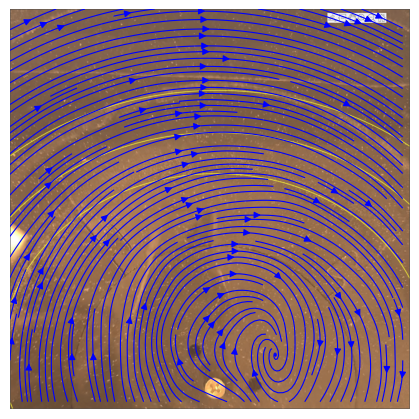

Loading data from: /uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_1f/PIV_run1.mat
Calculating mean velocity from timestep 185 to 189
Averaged over 5 timesteps.
Grid dimensions: Rows=55, Cols=55
Figure saved as: /uio/hume/student-u17/rafalbz/Documents/master/final/results/streamlines_mean/smooth_1f/PIV_run1_streamline_mean_185-189.png with dimensions 55x55


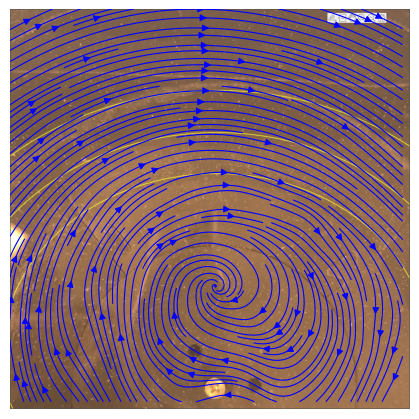

Loading data from: /uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_1f/PIV_run2.mat
Calculating mean velocity from timestep 23 to 27
Averaged over 5 timesteps.
Grid dimensions: Rows=55, Cols=55
Figure saved as: /uio/hume/student-u17/rafalbz/Documents/master/final/results/streamlines_mean/smooth_1f/PIV_run2_streamline_mean_23-27.png with dimensions 55x55


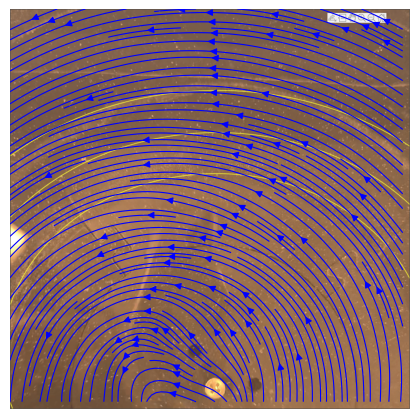

Loading data from: /uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_1f/PIV_run2.mat
Calculating mean velocity from timestep 26 to 30
Averaged over 5 timesteps.
Grid dimensions: Rows=55, Cols=55
Figure saved as: /uio/hume/student-u17/rafalbz/Documents/master/final/results/streamlines_mean/smooth_1f/PIV_run2_streamline_mean_26-30.png with dimensions 55x55


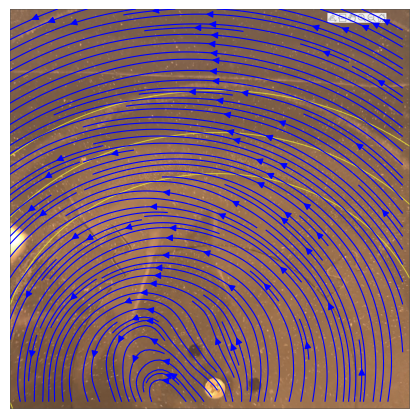

Loading data from: /uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_1f/PIV_run2.mat
Calculating mean velocity from timestep 55 to 59
Averaged over 5 timesteps.
Grid dimensions: Rows=55, Cols=55
Figure saved as: /uio/hume/student-u17/rafalbz/Documents/master/final/results/streamlines_mean/smooth_1f/PIV_run2_streamline_mean_55-59.png with dimensions 55x55


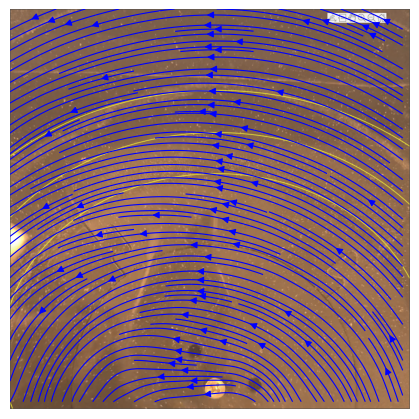

Loading data from: /uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_1f/PIV_run2.mat
Calculating mean velocity from timestep 115 to 119
Averaged over 5 timesteps.
Grid dimensions: Rows=55, Cols=55
Figure saved as: /uio/hume/student-u17/rafalbz/Documents/master/final/results/streamlines_mean/smooth_1f/PIV_run2_streamline_mean_115-119.png with dimensions 55x55


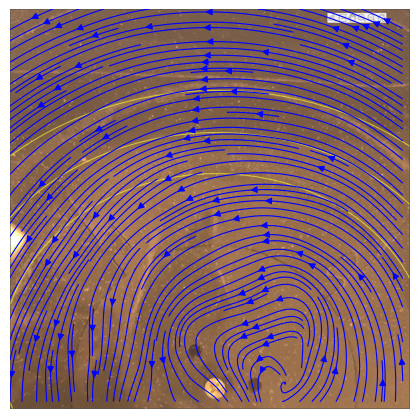

Loading data from: /uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_1f/PIV_run2.mat
Calculating mean velocity from timestep 188 to 192
Averaged over 5 timesteps.
Grid dimensions: Rows=55, Cols=55
Figure saved as: /uio/hume/student-u17/rafalbz/Documents/master/final/results/streamlines_mean/smooth_1f/PIV_run2_streamline_mean_188-192.png with dimensions 55x55


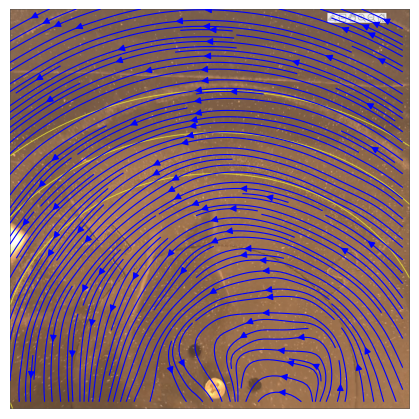

Loading data from: /uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_2f/PIV_run1.mat
Calculating mean velocity from timestep 28 to 32
Averaged over 5 timesteps.
Grid dimensions: Rows=55, Cols=55
Figure saved as: /uio/hume/student-u17/rafalbz/Documents/master/final/results/streamlines_mean/smooth_2f/PIV_run1_streamline_mean_28-32.png with dimensions 55x55


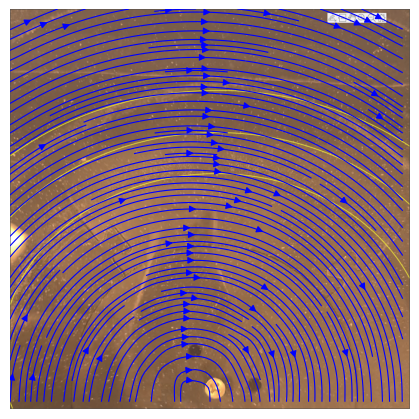

Loading data from: /uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_2f/PIV_run1.mat
Calculating mean velocity from timestep 31 to 35
Averaged over 5 timesteps.
Grid dimensions: Rows=55, Cols=55
Figure saved as: /uio/hume/student-u17/rafalbz/Documents/master/final/results/streamlines_mean/smooth_2f/PIV_run1_streamline_mean_31-35.png with dimensions 55x55


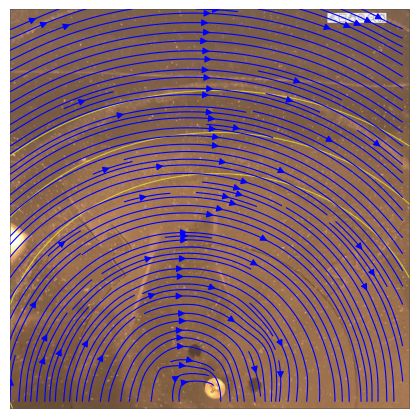

Loading data from: /uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_2f/PIV_run1.mat
Calculating mean velocity from timestep 60 to 64
Averaged over 5 timesteps.
Grid dimensions: Rows=55, Cols=55
Figure saved as: /uio/hume/student-u17/rafalbz/Documents/master/final/results/streamlines_mean/smooth_2f/PIV_run1_streamline_mean_60-64.png with dimensions 55x55


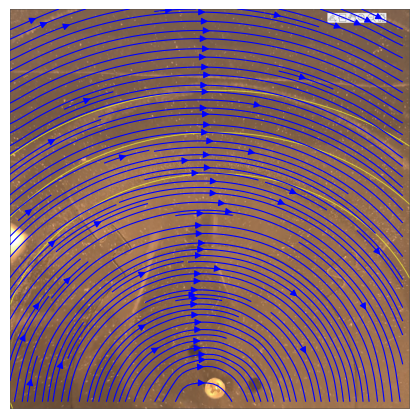

Loading data from: /uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_2f/PIV_run1.mat
Calculating mean velocity from timestep 120 to 124
Averaged over 5 timesteps.
Grid dimensions: Rows=55, Cols=55
Figure saved as: /uio/hume/student-u17/rafalbz/Documents/master/final/results/streamlines_mean/smooth_2f/PIV_run1_streamline_mean_120-124.png with dimensions 55x55


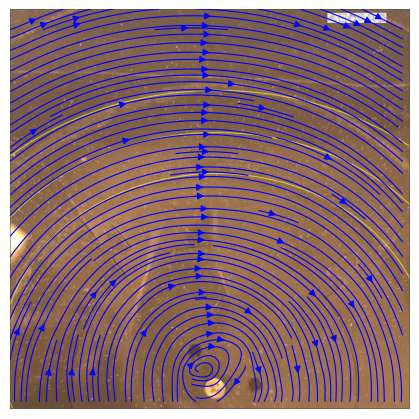

Loading data from: /uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_2f/PIV_run1.mat
Calculating mean velocity from timestep 193 to 197
Averaged over 5 timesteps.
Grid dimensions: Rows=55, Cols=55
Figure saved as: /uio/hume/student-u17/rafalbz/Documents/master/final/results/streamlines_mean/smooth_2f/PIV_run1_streamline_mean_193-197.png with dimensions 55x55


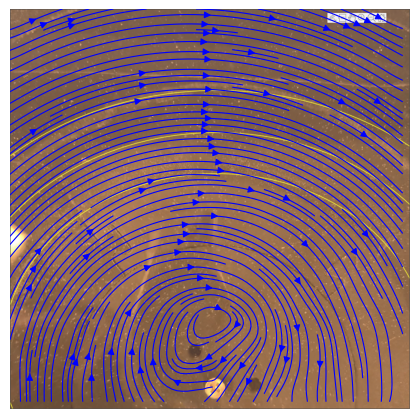

Loading data from: /uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_2f/PIV_run2.mat
Calculating mean velocity from timestep 28 to 32
Averaged over 5 timesteps.
Grid dimensions: Rows=55, Cols=55
Figure saved as: /uio/hume/student-u17/rafalbz/Documents/master/final/results/streamlines_mean/smooth_2f/PIV_run2_streamline_mean_28-32.png with dimensions 55x55


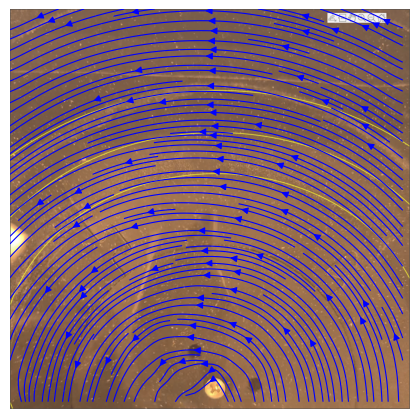

Loading data from: /uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_2f/PIV_run2.mat
Calculating mean velocity from timestep 31 to 35
Averaged over 5 timesteps.
Grid dimensions: Rows=55, Cols=55
Figure saved as: /uio/hume/student-u17/rafalbz/Documents/master/final/results/streamlines_mean/smooth_2f/PIV_run2_streamline_mean_31-35.png with dimensions 55x55


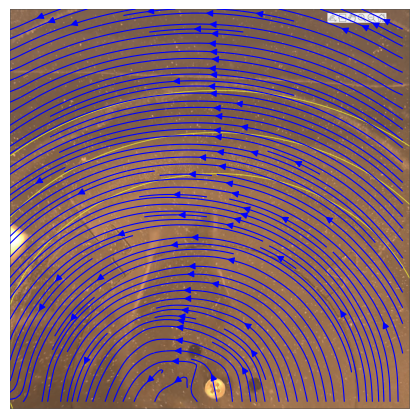

Loading data from: /uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_2f/PIV_run2.mat
Calculating mean velocity from timestep 60 to 64
Averaged over 5 timesteps.
Grid dimensions: Rows=55, Cols=55
Figure saved as: /uio/hume/student-u17/rafalbz/Documents/master/final/results/streamlines_mean/smooth_2f/PIV_run2_streamline_mean_60-64.png with dimensions 55x55


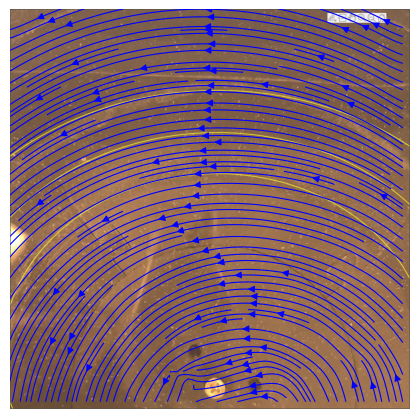

Loading data from: /uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_2f/PIV_run2.mat
Calculating mean velocity from timestep 120 to 124
Averaged over 5 timesteps.
Grid dimensions: Rows=55, Cols=55
Figure saved as: /uio/hume/student-u17/rafalbz/Documents/master/final/results/streamlines_mean/smooth_2f/PIV_run2_streamline_mean_120-124.png with dimensions 55x55


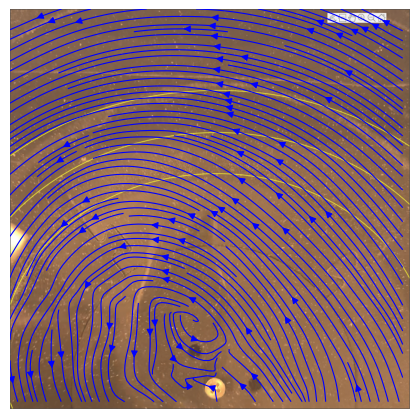

Loading data from: /uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_2f/PIV_run2.mat
Calculating mean velocity from timestep 193 to 197
Averaged over 5 timesteps.
Grid dimensions: Rows=55, Cols=55
Figure saved as: /uio/hume/student-u17/rafalbz/Documents/master/final/results/streamlines_mean/smooth_2f/PIV_run2_streamline_mean_193-197.png with dimensions 55x55


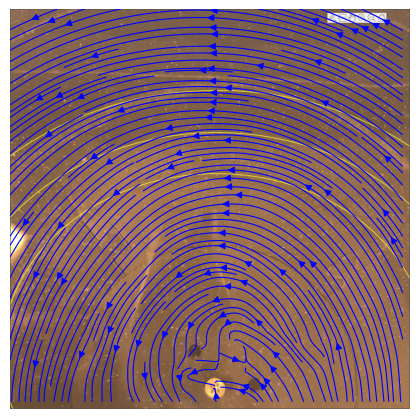

In [47]:
main('/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_1f/PIV_run1.mat',
      '/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_contour.png', 20, 'Smooth')
main('/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_1f/PIV_run1.mat',
      '/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_contour.png', 20+3,'Smooth')
main('/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_1f/PIV_run1.mat',
      '/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_contour.png', 20+32,'Smooth')
main('/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_1f/PIV_run1.mat',
      '/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_contour.png', 20+92,'Smooth')
main('/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_1f/PIV_run1.mat',
      '/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_contour.png', 20+165,'Smooth')

main('/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_1f/PIV_run2.mat',
      '/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_contour.png', 23,'Smooth')
main('/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_1f/PIV_run2.mat',
      '/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_contour.png', 23+3,'Smooth')
main('/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_1f/PIV_run2.mat',
      '/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_contour.png', 23+32,'Smooth')
main('/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_1f/PIV_run2.mat',
      '/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_contour.png', 23+92,'Smooth')
main('/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_1f/PIV_run2.mat',
      '/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_contour.png', 23+165,'Smooth')

main('/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_2f/PIV_run1.mat',
      '/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_contour.png', 28,'Smooth')
main('/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_2f/PIV_run1.mat',
      '/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_contour.png', 28+3,'Smooth')
main('/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_2f/PIV_run1.mat',
      '/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_contour.png', 28+32,'Smooth')
main('/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_2f/PIV_run1.mat',
      '/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_contour.png', 28+92,'Smooth')
main('/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_2f/PIV_run1.mat',
      '/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_contour.png', 28+165,'Smooth')

main('/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_2f/PIV_run2.mat',
      '/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_contour.png', 28,'Smooth')
main('/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_2f/PIV_run2.mat',
      '/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_contour.png', 28+3,'Smooth')
main('/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_2f/PIV_run2.mat',
      '/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_contour.png', 28+32,'Smooth')
main('/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_2f/PIV_run2.mat',
      '/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_contour.png', 28+92,'Smooth')
main('/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_2f/PIV_run2.mat',
      '/uio/hume/student-u17/rafalbz/Documents/master/final/source/29.03/smooth_contour.png', 28+165,'Smooth')

In [ ]:

import numpy as np
import scipy.io
import matplotlib.pyplot as plt
from matplotlib.image import imread
from pathlib import Path

def load_mat_file(filepath):
    data = scipy.io.loadmat(filepath)
    return data


def main(path, im, start_timestep, feat, num_steps_to_average=5):
    mat_filepath = path
    print(f"Loading data from: {mat_filepath}")

    data = load_mat_file(mat_filepath)
    if 'U2' in data and 'V2' in data:
        U = data['U2']
        V = data['V2']
    elif 'U' in data and 'V' in data:
        U = data['U']
        V = data['V']
    else:
        print("Error: Could not find velocity fields ('U', 'V' or 'U2', 'V2') in .mat file.")
        return


    print(f"Calculating mean velocity from timestep {start_timestep} to {start_timestep + num_steps_to_average - 1}")


    if start_timestep >= U.shape[1]:
        print(f"Error: Start timestep {start_timestep} is out of bounds (max: {U.shape[1]-1})")
        return


    U_accum = np.zeros_like(U[0, start_timestep], dtype=float)
    V_accum = np.zeros_like(V[0, start_timestep], dtype=float)
    valid_step_count = 0


    for t in range(start_timestep, start_timestep + num_steps_to_average):
        if t < U.shape[1]:
            U_accum += U[0, t]
            V_accum += V[0, t]
            valid_step_count += 1
        else:
            print(f"Warning: Timestep {t} is out of bounds, skipping.")
            break

    if valid_step_count == 0:
        print("Error: No valid timesteps found in the specified range.")
        return

    # mean
    U_mean = U_accum / valid_step_count
    V_mean = V_accum / valid_step_count
    print(f"Averaged over {valid_step_count} timesteps.")

  
    numRows, numCols = U_mean.shape
    print(f"Grid dimensions: Rows={numRows}, Cols={numCols}")
    X, Y = np.meshgrid(np.arange(numCols), np.arange(numRows))


    display_width_inches = 4
    aspect_ratio = numRows / numCols
    display_height_inches = display_width_inches * aspect_ratio



    fig, ax = plt.subplots(1, 1, figsize=(display_width_inches, display_height_inches))
    fig.subplots_adjust(left=0, right=1, top=1, bottom=0)


    image = im
    if image:
        try:
            img = imread(image)
            ax.imshow(img, extent=[0, numCols, 0, numRows], alpha=0.8, origin='lower')
        except FileNotFoundError:
            print(f"Warning: Background image not found at {image}")


    startx = np.linspace(0, numCols - 1, 20)
    starty = np.linspace(0, numRows - 1, 20)
    start_points_meshgrid = np.array(np.meshgrid(startx, starty))
    start_points = start_points_meshgrid.T.reshape(-1, 2)


    try:
        strm = ax.streamplot(X, Y, U_mean, V_mean, start_points=start_points, density=4.5, linewidth=0.6, color ='rebeccapurple',
                             integration_direction = 'both')
    except ValueError as e:
        print(f"Error during streamplot: {e}")
        plt.close(fig)
        return


    ax.set_xlim(0, numCols)
    ax.set_ylim(0, numRows)
    ax.set_aspect('auto')
    ax.invert_yaxis()
    ax.axis('off')


    p = Path(path)
    plot_save_name_parts = f"{p.parent.name}/{p.stem}"
    save_dir = Path("/uio/hume/student-u17/rafalbz/Documents/master/final/results/streamlines_mean/")

    save_filename = f"{plot_save_name_parts}_streamline_mean_{start_timestep}-{start_timestep+valid_step_count-1}_frontpage.png"
    full_save_path = save_dir / save_filename
    full_save_path.parent.mkdir(parents=True, exist_ok=True)


    save_dpi = numCols / display_width_inches


    fig.savefig(full_save_path, dpi=400, pad_inches=0)
    print(f"Figure saved as: {full_save_path} with dimensions {numCols}x{numRows}")

    plt.show()

    plt.close(fig)


Loading data from: /uio/hume/student-u17/rafalbz/Documents/master/final/source/28.03/canyon_1f/PIV_run6.mat
Calculating mean velocity from timestep 190 to 194
Averaged over 5 timesteps.
Grid dimensions: Rows=55, Cols=55
Figure saved as: /uio/hume/student-u17/rafalbz/Documents/master/final/results/streamlines_mean/canyon_1f/PIV_run6_streamline_mean_190-194_frontpage.png with dimensions 55x55


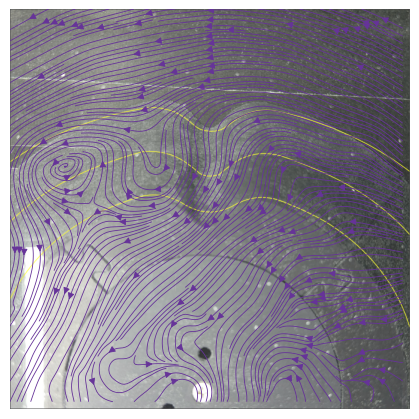

In [40]:
main('/uio/hume/student-u17/rafalbz/Documents/master/final/source/28.03/canyon_1f/PIV_run6.mat',
      '/uio/hume/student-u17/rafalbz/Documents/master/final/source/28.03/canyon_contour.png', 27+165-2,'Canyon')